In [2]:
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
import librosa
import librosa.display
import subprocess
import os


In [4]:
class Tonal_Fragment:
    """
    Analyzes the musical key of an audio file using the Krumhansl-Schmuckler algorithm.
    
    The algorithm compares the chromatic distribution of the audio to typical profiles
    of major and minor keys to determine the most likely key.
    
    Attributes:
        waveform: Audio data loaded by librosa
        sr: Sampling rate of the audio
        tstart: Start time in seconds (optional)
        tend: End time in seconds (optional)
        key: The detected musical key
        bestcorr: Correlation coefficient of the detected key
        altkey: Alternative key if correlation is close to the best match
        altbestcorr: Correlation coefficient of the alternative key
    """
    
    PITCHES = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    # Krumhansl-Schmuckler key profiles
    MAJ_PROFILE = [6.35, 2.23, 3.48, 2.33, 4.38, 4.09, 2.52, 5.19, 2.39, 3.66, 2.29, 2.88]
    MIN_PROFILE = [6.33, 2.68, 3.52, 5.38, 2.60, 3.53, 2.54, 4.75, 3.98, 2.69, 3.34, 3.17]
    
    def __init__(self, waveform, sr, tstart=None, tend=None):
        """
        Initialize Tonal_Fragment and analyze the audio.
        
        Args:
            waveform: Audio waveform array from librosa
            sr: Sampling rate
            tstart: Start time in seconds (default: beginning of file)
            tend: End time in seconds (default: end of file)
        """
        self.waveform = waveform
        self.sr = sr
        self.tstart = tstart
        self.tend = tend
        
        # Convert time boundaries to sample indices
        if self.tstart is not None:
            self.tstart = librosa.time_to_samples(self.tstart, sr=self.sr)
        if self.tend is not None:
            self.tend = librosa.time_to_samples(self.tend, sr=self.sr)
        
        # Extract segment and compute chromagram
        self.y_segment = self.waveform[self.tstart:self.tend]
        self.chromograph = librosa.feature.chroma_cqt(
            y=self.y_segment, 
            sr=self.sr, 
            bins_per_octave=24
        )
        
        # Calculate total chroma values for each pitch class
        self.chroma_vals = [np.sum(self.chromograph[i]) for i in range(12)]
        self.keyfreqs = {self.PITCHES[i]: self.chroma_vals[i] for i in range(12)}
        
        # Compute correlations with key profiles
        self._compute_key_correlations()
        
        # Determine primary and alternative keys
        self.key = max(self.key_dict, key=self.key_dict.get)
        self.bestcorr = self.key_dict[self.key]
        
        # Find alternative key if correlation is within 90% of best
        self.altkey = None
        self.altbestcorr = None
        self._find_alternative_key()
    
    def _compute_key_correlations(self):
        """Compute correlation coefficients for all 24 major/minor keys."""
        maj_key_corrs = []
        min_key_corrs = []
        
        for i in range(12):
            # Rotate pitch frequencies to match each key
            key_test = [self.keyfreqs.get(self.PITCHES[(i + m) % 12]) for m in range(12)]
            
            # Calculate correlation with major and minor profiles
            maj_corr = round(np.corrcoef(self.MAJ_PROFILE, key_test)[1, 0], 3)
            min_corr = round(np.corrcoef(self.MIN_PROFILE, key_test)[1, 0], 3)
            
            maj_key_corrs.append(maj_corr)
            min_key_corrs.append(min_corr)
        
        # Create dictionary mapping key names to correlation coefficients
        keys = [self.PITCHES[i] + ' major' for i in range(12)] + \
               [self.PITCHES[i] + ' minor' for i in range(12)]
        
        self.key_dict = {
            **{keys[i]: maj_key_corrs[i] for i in range(12)},
            **{keys[i + 12]: min_key_corrs[i] for i in range(12)}
        }
    
    def _find_alternative_key(self):
        """Find alternative key if its correlation is within 90% of the best."""
        for key, corr in self.key_dict.items():
            if corr > self.bestcorr * 0.9 and corr != self.bestcorr:
                self.altkey = key
                self.altbestcorr = corr
                break
    
    def get_key_with_context(self, prefer_minor=False, threshold=0.9):
        """
        Get the detected key with option to prefer minor keys for relative key pairs.
        
        This helps disambiguate between relative major/minor keys (e.g., C major vs A minor).
        
        Args:
            prefer_minor: If True, prefer minor keys when they're close to major correlations
            threshold: Correlation threshold for preferring minor (default: 0.9)
        
        Returns:
            Tuple of (key_name, correlation_coefficient)
        """
        key = self.key
        bestcorr = self.bestcorr
        
        # Check if a relative minor key is very close in correlation
        if prefer_minor and 'major' in key:
            root = key.split()[0]
            # Calculate relative minor (3 semitones down)
            idx = self.PITCHES.index(root)
            relative_minor = self.PITCHES[(idx - 3) % 12] + ' minor'
            
            if relative_minor in self.key_dict:
                minor_corr = self.key_dict[relative_minor]
                # If minor correlation exceeds threshold, prefer minor
                if minor_corr > bestcorr * threshold:
                    return relative_minor, minor_corr
        
        return key, bestcorr
    
    def print_chroma(self):
        """Print the relative prominence of each pitch class."""
        chroma_max = max(self.chroma_vals)
        for pitch, chrom in self.keyfreqs.items():
            print(f"{pitch}\t{chrom / chroma_max:5.3f}")
    
    def corr_table(self):
        """Print correlation coefficients for all major/minor keys."""
        for key, corr in sorted(self.key_dict.items()):
            print(f"{key}\t{corr:6.3f}")
    
    def print_key(self):
        """Print the detected key and alternative key (if available)."""
        key, corr = self.get_key_with_context(prefer_minor=True)
        print(f"Detected key: {key}, correlation: {corr}")
        if self.altkey is not None:
            print(f"also possible: {self.altkey}, correlation: {self.altbestcorr}")
    
    def chromagram(self, title=None):
        """
        Display a chromagram of the audio file.
        
        The chromagram shows the intensity of frequencies associated with each
        of the 12 pitch classes over time.
        
        Args:
            title: Title for the plot (default: 'Chromagram')
        """
        C = librosa.feature.chroma_cqt(y=self.waveform, sr=self.sr, bins_per_octave=24)
        plt.figure(figsize=(12, 4))
        librosa.display.specshow(C, sr=self.sr, x_axis='time', y_axis='chroma', vmin=0, vmax=1)
        plt.title(title if title else 'Chromagram')
        plt.colorbar()
        plt.tight_layout()
        plt.show()

In [5]:
def convert_mp3_to_wav(mp3_file):
    """Convert MP3 to WAV using ffmpeg if needed"""
    wav_file = mp3_file.replace('.mp3', '.wav')
    if not os.path.exists(wav_file) and os.path.exists(mp3_file):
        try:
            subprocess.run(['ffmpeg', '-i', mp3_file, '-acodec', 'pcm_s16le', '-ar', '22050', wav_file, '-y'], 
                          capture_output=True, check=True)
            print(f"Converted {mp3_file} to {wav_file}")
            return wav_file
        except Exception as e:
            print(f"Conversion failed, will try loading MP3 directly: {e}")
            return mp3_file
    return wav_file if os.path.exists(wav_file) else mp3_file

# Convert all MP3 files in the directory
mp3_files = ['Engima.mp3','sweet-home-alabama.mp3',"une-barque-sur-l'ocean.mp3","angry-birds-theme-song.mp3"]
for mp3 in mp3_files:
    if os.path.exists(mp3):
        convert_mp3_to_wav(mp3)

# this audio takes a long time to load because it has a very high sampling rate; be patient.
audio_path = 'Engima.wav'
# the load function generates a tuple consisting of an audio object y and its sampling rate sr
y, sr = librosa.load(audio_path)
# this function filters out the harmonic part of the sound file from the percussive part, allowing for
# more accurate harmonic analysis
y_harmonic, y_percussive = librosa.effects.hpss(y)
ipd.Audio(audio_path)

Converted Engima.mp3 to Engima.wav
Converted sweet-home-alabama.mp3 to sweet-home-alabama.wav
Converted une-barque-sur-l'ocean.mp3 to une-barque-sur-l'ocean.wav
Converted angry-birds-theme-song.mp3 to angry-birds-theme-song.wav


In [6]:
# this block instantiates the Tonal_Fragment class with the first 22 seconds of the above harmonic part of une barque.
# the three methods called will print the determined key of the song, the correlation coefficients for all keys,
# and a chromogram, which shows the intensity of frequencies associated with each of the 12 pitch classes over time.

unebarque_fsharp_min = Tonal_Fragment(y_harmonic, sr)
unebarque_fsharp_min.print_chroma()

C	1.000
C#	0.627
D	0.920
D#	0.652
E	0.956
F	0.618
F#	0.668
G	0.993
G#	0.670
A	0.835
A#	0.645
B	0.979


Detected key: E minor, correlation: 0.793
also possible: E minor, correlation: 0.793
A major	 0.174
A minor	 0.527
A# major	-0.254
A# minor	-0.739
B major	-0.061
B minor	 0.446
C major	 0.706
C minor	 0.249
C# major	-0.793
C# minor	-0.199
D major	 0.417
D minor	 0.104
D# major	-0.294
D# minor	-0.593
E major	 0.215
E minor	 0.793
F major	 0.080
F minor	-0.372
F# major	-0.596
F# minor	-0.237
G major	 0.860
G minor	 0.188
G# major	-0.455
G# minor	-0.166


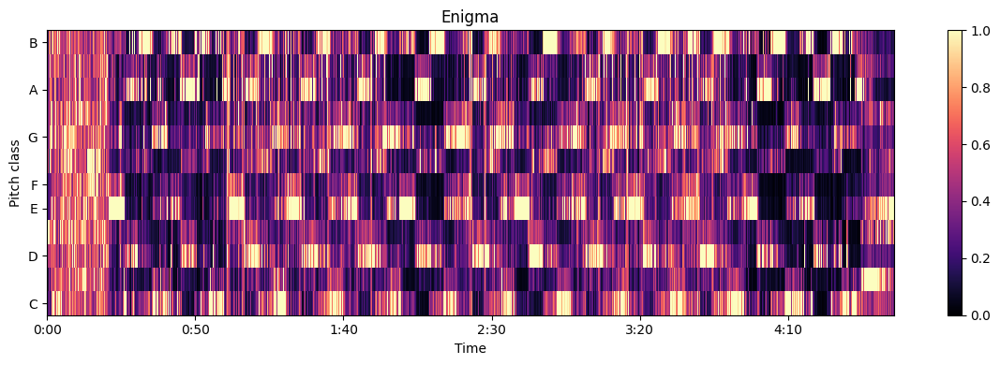

In [7]:
unebarque_fsharp_min.print_key()
unebarque_fsharp_min.corr_table()
unebarque_fsharp_min.chromagram("Enigma")

In [8]:
# parts of the song that are more tonally ambiguous will show two keys with print_key(),
# if they are similarly well-correlated.
# this section of une barque is in E minor, though the algorithm suggests that it is in D major, a closely related key,
# though E minor is also listed since their correlation coefficients are very close.
unebarque_e_min = Tonal_Fragment(y_harmonic, sr, tstart=22, tend=33)
unebarque_e_min.print_key()
unebarque_e_min.corr_table()

Detected key: D major, correlation: 0.638
also possible: A minor, correlation: 0.598
A major	 0.567
A minor	 0.598
A# major	-0.143
A# minor	-0.604
B major	 0.106
B minor	 0.560
C major	 0.251
C minor	-0.195
C# major	-0.854
C# minor	-0.190
D major	 0.638
D minor	 0.341
D# major	-0.394
D# minor	-0.309
E major	 0.371
E minor	 0.521
F major	 0.069
F minor	-0.652
F# major	-0.438
F# minor	 0.112
G major	 0.508
G minor	-0.007
G# major	-0.680
G# minor	-0.175


In [9]:
# in the case of une barque sur l'ocean (and other songs), predictions become less reliable over short time frames
# the below block prints the predicted key of every 3-second-long cut of the piece.
bin_size = 3
for i in range(24):
    fragment = Tonal_Fragment(y_harmonic, sr, tstart = bin_size*i, tend=bin_size*(i+1))
    print(bin_size*i,"sec:",fragment.key)
    if fragment.altkey is not None:
        print("\t or:", fragment.altkey)

0 sec: D# minor
3 sec: C minor
6 sec: G# major
	 or: C minor
9 sec: C# minor
12 sec: C# major
15 sec: D# minor
18 sec: A# major
	 or: D# major
21 sec: E minor
24 sec: E minor
27 sec: D major
30 sec: B minor
33 sec: B minor
36 sec: C major
39 sec: C major
42 sec: E minor
45 sec: D major
48 sec: D major
51 sec: B minor
54 sec: C major
	 or: C minor
57 sec: C major
60 sec: A minor
63 sec: E minor
66 sec: D major
69 sec: D major


Detected key: G major, correlation: 0.803
A major	-0.028
A minor	 0.074
A# major	 0.107
A# minor	-0.562
B major	-0.427
B minor	 0.303
C major	 0.359
C minor	 0.326
C# major	-0.501
C# minor	-0.437
D major	 0.651
D minor	 0.438
D# major	 0.117
D# minor	-0.306
E major	-0.405
E minor	 0.225
F major	 0.029
F minor	-0.287
F# major	-0.521
F# minor	-0.128
G major	 0.803
G minor	 0.652
G# major	-0.183
G# minor	-0.298


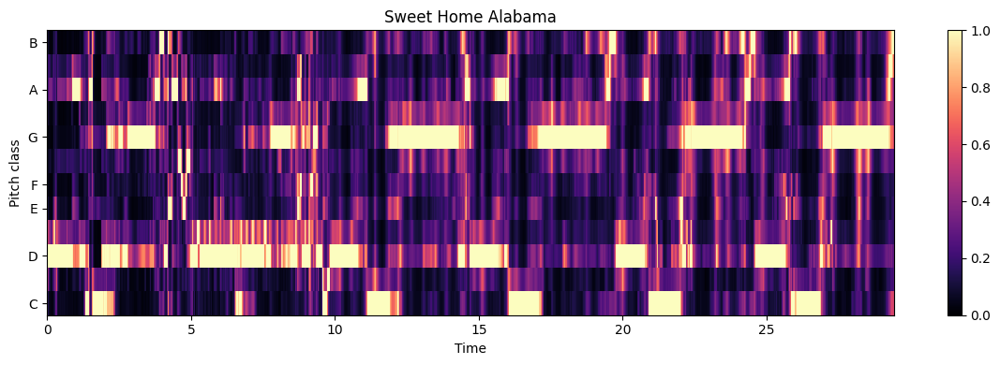

In [10]:
# lynyrd skynyrd's "sweet home alabama" is a song famously contentious among music theorists due to its ambiguous key;
# it is oft debated whether it is in G major or D major. in this instance, the algorithm chooses G major over D major 
# by a wide margin, not even reporting D major as a possible alternative. this is just one example of the human ear's
# impression disagreeing with this simple algorithm.

audio_path = 'sweet-home-alabama.wav'
y, sr = librosa.load(audio_path)
y_harmonic, y_percussive = librosa.effects.hpss(y)

song = Tonal_Fragment(y_harmonic, sr)
song.print_key()
song.corr_table()
song.chromagram("Sweet Home Alabama")

In [11]:
ipd.Audio(audio_path)

Detected key: E minor, correlation: 0.668
A major	 0.014
A minor	 0.140
A# major	-0.194
A# minor	-0.442
B major	 0.522
B minor	 0.489
C major	 0.265
C minor	 0.007
C# major	-0.518
C# minor	-0.046
D major	-0.027
D minor	-0.123
D# major	-0.273
D# minor	-0.089
E major	 0.493
E minor	 0.668
F major	-0.066
F minor	-0.223
F# major	-0.185
F# minor	-0.316
G major	 0.325
G minor	-0.270
G# major	-0.357
G# minor	 0.204


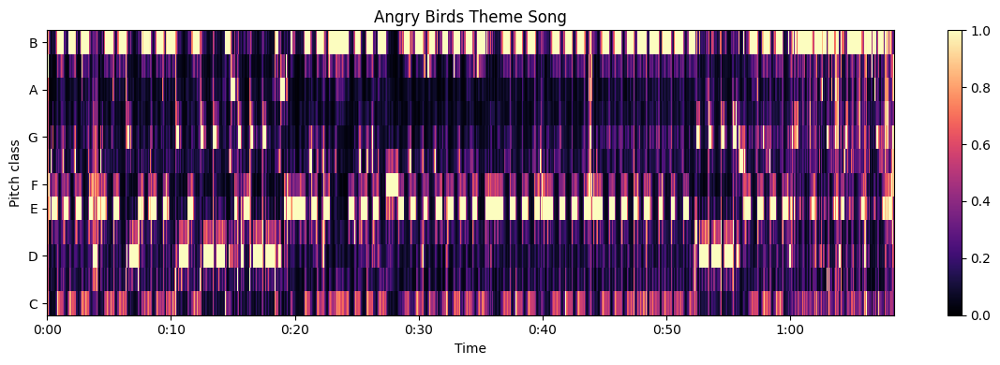

In [12]:
# the Angry Birds theme song is another song that can be analyzed correctly by the algorithm.
# the whole piece is in E minor, in agreement with the result below.

audio_path = 'angry-birds-theme-song.mp3'
y, sr = librosa.load(audio_path)
y_harmonic, y_percussive = librosa.effects.hpss(y)

angry_birds_e_min = Tonal_Fragment(y_harmonic, sr, tstart=0.4)
angry_birds_e_min.print_key()
angry_birds_e_min.corr_table()
angry_birds_e_min.chromagram("Angry Birds Theme Song")

In [13]:
ipd.Audio(audio_path)